In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker
import sklearn
from sklearn.decomposition import PCA
from sklearn import preprocessing
import matplotlib.image as mpimg
import scipy
from sklearn.manifold import TSNE
from matplotlib import offsetbox
import matplotlib.patches as mpatches
import scipy.stats as stats
import cv2
import glob
import os

%matplotlib inline

# DilatedNet - Semantic segmentation 

In [119]:
#Reading the features file
feats=np.loadtxt("datasets/categoryIndex_semantic_segmentation150.csv",dtype=bytes,usecols=True,delimiter=",").astype(str)
feats=np.append(["image_name"],feats[1:])
feats=[e.split("|")[0] for e in feats]

In [120]:
#Reading the csv file generated by googlenet_places205
features_ss150=pd.read_csv("datasets/dilatednet_segmentation150-class_summary.csv",header=None,names=feats)

In [121]:
features_ss150["prob"]=features_ss150.loc[:,features_ss150.columns!="image_name"].max(axis=1)
features_ss150["most_prob_feat"]=(features_ss150.loc[:,((features_ss150.columns!="image_name") & (features_ss150.columns!="prob"))]).idxmax(axis=1)
cols=["image_name"]+features_ss150.columns.tolist()[-2:]+features_ss150.columns.tolist()[1:-2]
features_ss150=features_ss150[cols]
features_ss150.head()

,image_name,prob,most_prob_feat,wall,building,sky,floor,tree,ceiling,road,...,pier,crt screen,plate,monitor,bulletin board,shower,radiator,glass,clock,flag
0,s_20140101_125134.jpg,0.495103,building,0.007447,0.495103,0.075117,0.352118,0.000359,0.0,0.022035,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,s_20140101_125419.jpg,0.390094,building,0.000000,0.390094,0.314747,0.008074,0.000000,0.0,0.089085,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,s_20140101_125819.jpg,0.404141,sidewalk,0.000000,0.284519,0.148422,0.026618,0.030529,0.0,0.025390,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,s_20140101_125835.jpg,0.470173,building,0.000000,0.470173,0.035024,0.000000,0.000000,0.0,0.112055,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,s_20140101_125939.jpg,0.612354,building,0.006698,0.612354,0.063612,0.000000,0.002196,0.0,0.181298,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [122]:
count_feat=features_ss150[['most_prob_feat',"prob"]].groupby(by="most_prob_feat",as_index=False).count().sort_values("prob",ascending=False)
count_feat.columns=["feat","count"]
count_feat=count_feat.head(10)

In [123]:
#Percentage of pictures with the dominant feature within the top-10
count_feat.sum(axis=0,numeric_only=True)/1200*100

count    99.25
dtype: float64

In [124]:
count_feat.replace(to_replace={"building ":"Building","sidewalk ":"Sidewalk","road ":"Road","sky":"Sky","wall":"Wall",
                              "tree":"Tree","car ":"Car","earth ":"Earth","person ":"Person","floor":"floor"},inplace=True)

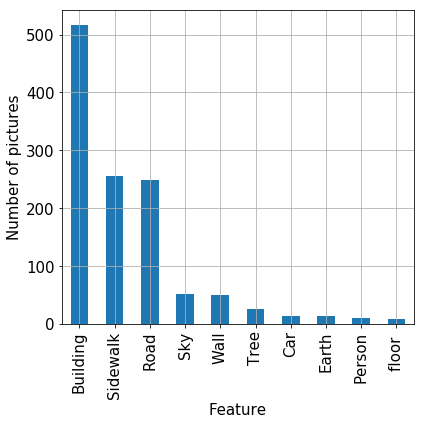

In [125]:
count_feat.set_index("feat",inplace=True)
count_feat.plot(kind="bar",use_index=True,grid=True,figsize=[6,6],legend=False,fontsize=15)
plt.xlabel("Feature",fontsize=15)
plt.ylabel("Number of pictures",fontsize=15)
plt.tight_layout()
plt.savefig('plots/dilatednet_top_10_objects.jpg',dpi=900)

# GoogleNet - Places205

In [126]:
#Reading the features file
feats=np.loadtxt("datasets/categoryIndex_places205.csv",dtype=bytes,usecols=0).astype(str)
feats=[e[3:] for e in feats]
feats=np.append(["image_name","most_prob_feat","prob"],feats)

In [127]:
#Reading the csv file generated by googlenet_places205
features_p205=pd.read_csv("datasets/googlenet_places205-class-prob-summary.csv",header=None,names=feats)
features_p205["most_prob_feat"]=[e[3:].split(" ")[0] for e in features_p205["most_prob_feat"]]

In [128]:
features_p205.head(n=5)

,image_name,most_prob_feat,prob,abbey,airport_terminal,alley,amphitheater,amusement_park,aquarium,aqueduct,...,veranda,viaduct,volcano,waiting_room,water_tower,watering_hole,wheat_field,wind_farm,windmill,yard
0,GC_s_20140101_125134.jpg,alley,0.877149,0.000100,0.000006,0.877149,0.000044,0.000086,0.000002,0.000048,...,0.000209,0.000031,0.000027,0.000006,0.000102,2.400000e-07,0.000002,0.000005,0.000048,0.000130
1,GC_s_20140101_125419.jpg,alley,0.294856,0.001102,0.000028,0.294856,0.000114,0.000283,0.000011,0.000479,...,0.000085,0.000343,0.001344,0.000016,0.002066,4.060000e-06,0.000048,0.000045,0.000321,0.000814
2,GC_s_20140101_125819.jpg,plaza,0.748392,0.003951,0.000007,0.023215,0.000105,0.000565,0.000006,0.000772,...,0.000021,0.000082,0.000093,0.000004,0.000174,2.000000e-06,0.000004,0.000004,0.000072,0.000161
3,GC_s_20140101_125835.jpg,boardwalk,0.124242,0.000294,0.001060,0.074381,0.000237,0.028027,0.000167,0.000605,...,0.000331,0.002835,0.000720,0.000076,0.004734,7.700000e-06,0.000118,0.000430,0.002927,0.000330
4,GC_s_20140101_125939.jpg,alley,0.765077,0.000827,0.000017,0.765077,0.000071,0.000867,0.000012,0.000655,...,0.000024,0.002500,0.000037,0.000005,0.000788,1.060000e-06,0.000014,0.000041,0.000214,0.000094


In [129]:
count_feat=features_p205[['most_prob_feat',"prob"]].groupby(by="most_prob_feat",as_index=False).count().sort_values("prob",ascending=False)
count_feat.columns=["feat","count"]
count_feat=count_feat.head(10)

In [130]:
#Percentage of pictures with the dominant feature within the top-10
count_feat.sum(axis=0,numeric_only=True)/1200*100

count    89.583333
dtype: float64

In [131]:
count_feat.replace(to_replace={"alley":"Alley","parking_lot":"Parking lot","plaza":"Plaza",
                               "crosswalk":"Crosswalk","medina":"Medina","slum":"Slum","market/outdoor":"Market (Outdoor)",
                               "residential_neighborhood":"Residential neighborhood","construction_site":"Construction site",
                              "staircase":"Staircase"},inplace=True)

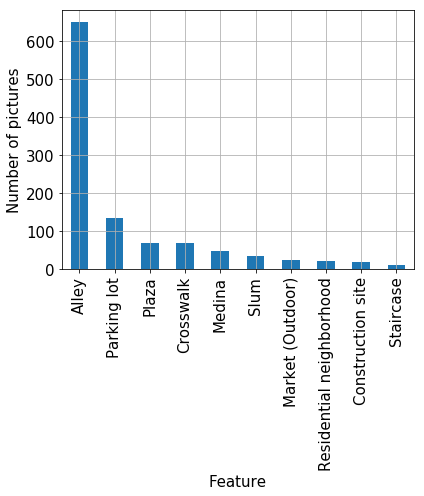

In [132]:
count_feat.set_index("feat",inplace=True)
count_feat.plot(kind="bar",use_index=True,grid=True,figsize=[6,7],legend=False,fontsize=15)
plt.xlabel("Feature",fontsize=15)
plt.ylabel("Number of pictures",fontsize=15)
plt.tight_layout()
plt.savefig('plots/places205_top_10_objects.jpg',dpi=900)

# GoogleNet - Places365

In [156]:
#Reading the features file
feats=np.loadtxt("datasets/categoryIndex_places365.txt",dtype=bytes,usecols=0).astype(str)
feats=[e[3:] for e in feats]
feats=np.append(["image_name","most_prob_feat","prob"],feats)

In [157]:
#Reading the csv file generated by googlenet_places365
features_p365=pd.read_csv("datasets/googlenet_places365-class-prob-summary.csv",header=None,names=feats)
features_p365["most_prob_feat"]=[e[3:].split(" ")[0] for e in features_p365["most_prob_feat"]]

In [158]:
features_p365.head(n=5)

,image_name,most_prob_feat,prob,airfield,airplane_cabin,airport_terminal,alcove,alley,amphitheater,amusement_arcade,...,waterfall,watering_hole,wave,wet_bar,wheat_field,wind_farm,windmill,yard,youth_hostel,zen_garden
0,s_20140712_144123.jpg,street,0.280269,0.000004,0.000007,0.000006,7.489374e-07,0.224470,0.000042,0.000011,...,5.046091e-06,6.404929e-06,0.000009,1.265554e-06,4.416850e-06,0.000009,0.000037,0.000477,0.000005,0.000010
1,s_20140531_104057.jpg,driveway,0.097190,0.000041,0.000032,0.000054,2.594588e-05,0.019120,0.000822,0.000023,...,1.193669e-05,1.481496e-05,0.000024,1.889427e-05,3.404022e-05,0.000050,0.000167,0.016354,0.000027,0.001293
2,s_20140724_153037.jpg,gas_station,0.248562,0.000005,0.000005,0.000366,1.807322e-06,0.073503,0.000031,0.000070,...,7.513713e-07,3.590881e-06,0.000005,4.912675e-06,1.504570e-06,0.000022,0.000029,0.000427,0.000004,0.000052
3,s_20140712_143102.jpg,street,0.723344,0.000002,0.000004,0.000005,3.099337e-07,0.069832,0.000010,0.000007,...,3.292676e-07,6.617962e-07,0.000002,6.878502e-07,9.954636e-07,0.000006,0.000012,0.000228,0.000001,0.000031
4,s_20140726_112633.jpg,medina,0.326112,0.000069,0.000005,0.000119,4.405641e-06,0.136932,0.000184,0.000028,...,1.044428e-06,1.023950e-05,0.000036,4.240542e-06,3.677368e-05,0.000086,0.000095,0.002661,0.000007,0.000344


In [167]:
features_p365[["image_name","most_prob_feat","gas_station"]].sort_values("gas_station",ascending=False).head(3)

,image_name,most_prob_feat,gas_station
145,s_20140724_152449.jpg,gas_station,0.675802
840,s_20140726_113032.jpg,gas_station,0.401075
958,s_20140724_153015.jpg,gas_station,0.381976


In [168]:
features_p365[["image_name","most_prob_feat","loading_dock"]].sort_values("loading_dock",ascending=False).head(3)

,image_name,most_prob_feat,loading_dock
546,s_20140724_150148.jpg,loading_dock,0.843305
383,s_20140515_092419.jpg,loading_dock,0.737406
1042,s_20140726_112600.jpg,loading_dock,0.652651


In [181]:
features_p365[features_p365["image_name"]=="s_20140108_131820.jpg"]["church/outdoor"]

74    0.126884
Name: church/outdoor, dtype: float64

In [175]:
features_p365[features_p365["image_name"]=="s_20140108_131820.jpg"].drop(["image_name","most_prob_feat","prob"],axis=1).transpose().sort_values(74,ascending=False)

,74
palace,2.741108e-01
castle,1.947187e-01
church/outdoor,1.268835e-01
plaza,7.741939e-02
tower,4.195397e-02
courtyard,3.362054e-02
formal_garden,3.025610e-02
mansion,2.966924e-02
campus,2.935722e-02
building_facade,2.391165e-02


In [159]:
count_feat=features_p365[['most_prob_feat',"prob"]].groupby(by="most_prob_feat",as_index=False).count().sort_values("prob",ascending=False)
count_feat.columns=["feat","count"]
count_feat=count_feat.head(10)

In [160]:
#Percentage of pictures with the dominant feature within the top-10
count_feat.sum(axis=0,numeric_only=True)/1200*100

count    82.833333
dtype: float64

In [161]:
count_feat.replace(to_replace={"street":"Street","alley":"Alley","medina":"Medina","parking_lot":"Parking Lot",
                              "bazaar/outdoor":"Bazaar (outdoor)","residential_neighborhood":"Residential neighborhood",
                              "loading_dock":"Loading dock", "industrial_area":"Industrial area","gas_station":"Gas station"},inplace=True)

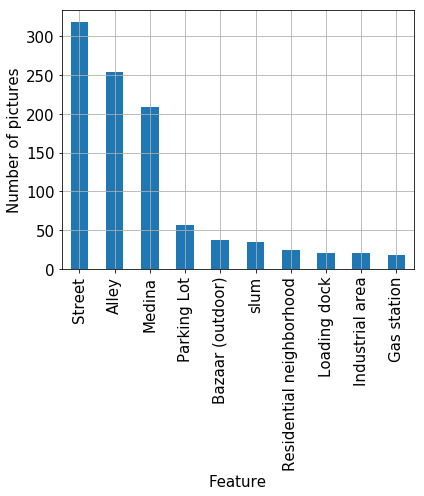

In [162]:
count_feat.set_index("feat",inplace=True)
count_feat.plot(kind="bar",use_index=True,grid=True,figsize=[6,7],legend=False,fontsize=15)
plt.xlabel("Feature",fontsize=15)
plt.ylabel("Number of pictures",fontsize=15)
plt.tight_layout()
plt.savefig('plots/places365_top_10_objects.jpg',dpi=900)

# PCA of the labels

In [2]:
#Load file
all_labels=pd.read_csv("datasets/all-places-all-labels-median-medina.csv",sep=",")

In [3]:
all_labels.head()

,annotation,Dangerous,Dirty,Pretty,Preserved,Accessible,Interesting,Picturesque,Wealthy,Quiet,Polluted,Pleasant,Happy,city
0,s_20140101_125134.jpg,2.0,2.0,5.0,5.0,5.0,5.5,4.5,3.5,5.0,2.0,5.0,5.5,gc
1,s_20140101_125419.jpg,2.5,3.0,3.0,4.0,5.0,5.0,3.0,2.5,3.0,2.5,4.0,4.0,gc
2,s_20140101_125819.jpg,2.0,2.5,5.0,6.0,6.0,6.0,5.5,2.0,3.0,2.0,6.0,6.0,gc
3,s_20140101_125835.jpg,4.0,4.0,3.0,4.0,5.0,4.5,2.5,2.0,2.5,3.0,4.0,4.0,gc
4,s_20140101_125939.jpg,3.0,3.0,5.0,5.0,6.0,5.5,5.0,2.5,4.0,2.5,5.5,5.5,gc


In [4]:
#PCA
n_components=2
x=all_labels.drop(["annotation","city"],axis=1)
#Scaling to unit variance
X_scaled = sklearn.preprocessing.scale(x)
print("Variance:\n", X_scaled.std(axis=0))
pca = sklearn.decomposition.PCA(n_components=n_components, svd_solver='full',whiten=True)
pca.fit(X_scaled)
print("Number of PC:", n_components)
print("Variance of the components:")
for i in range(len(pca.explained_variance_ratio_)):
    print("Component n."+str(i+1)+": "+str(round(pca.explained_variance_ratio_[i],4)*100)+"%")
print("\nTotal variance: "+str(round(sum(pca.explained_variance_ratio_),4)*100)+"%")
temp=[]
for i in range(1,n_components+1,1):
    temp.append("PC_"+str(i))
df_pca_labels=pd.DataFrame(pca.transform(X_scaled)) 
df_pca_labels.columns=temp
df_pca_labels["annotation"]=all_labels["annotation"].copy()

Variance:
 [ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.]
Number of PC: 2
Variance of the components:
Component n.1: 67.29%
Component n.2: 9.44%

Total variance: 76.73%


In [5]:
df_pca_labels.head()

,PC_1,PC_2,annotation
0,1.497765,1.397203,s_20140101_125134.jpg
1,0.280880,-0.224547,s_20140101_125419.jpg
2,1.749521,0.171591,s_20140101_125819.jpg
3,-0.203183,-0.400968,s_20140101_125835.jpg
4,1.302066,0.831742,s_20140101_125939.jpg


In [45]:
df_pca_labels.to_csv("datasets/all-places-mturk-2_pc-labels.csv",index=False,sep=",")

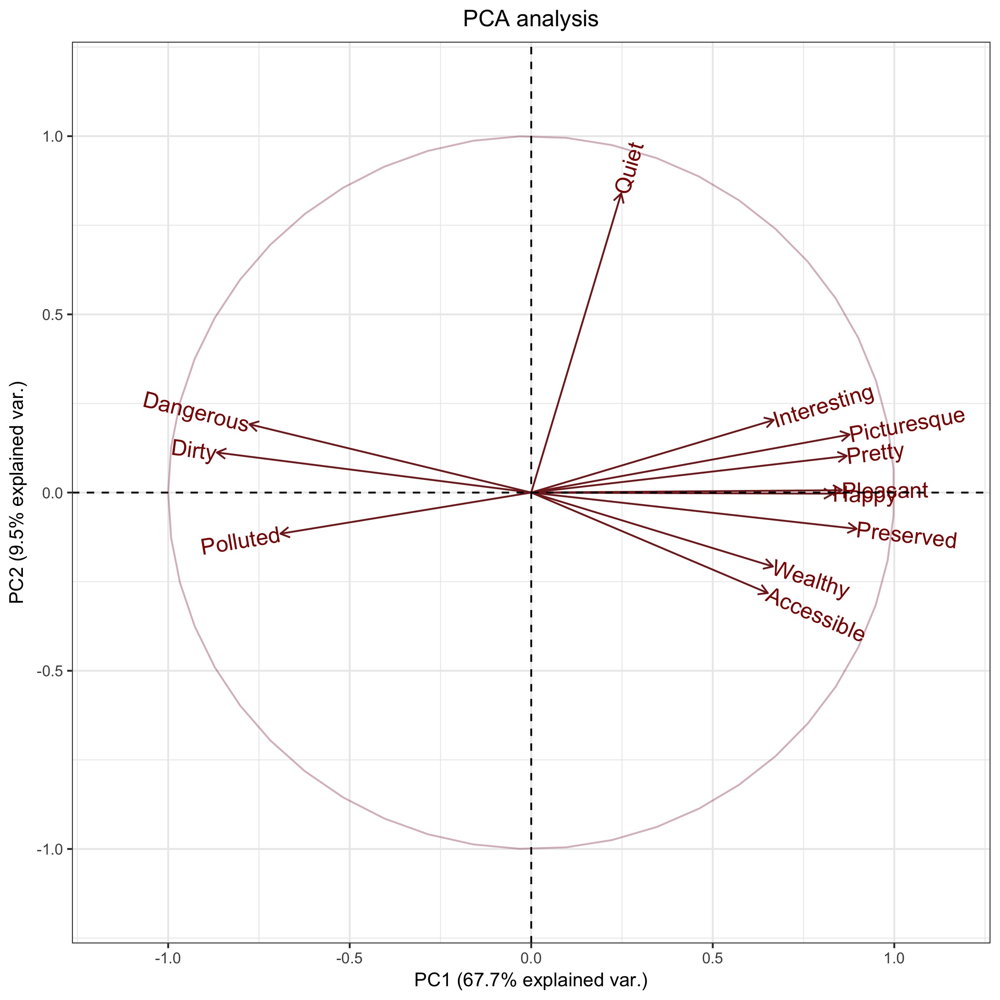

In [6]:
#Plotting the 2 first PCs
#The graphical analysis was made on RStudio ("scripts/pca_analysis_labels.R"), however here is the plot;
from IPython.display import Image
Image(filename="plots/2pcs.jpg")

# Correlation of the 12 labels

In [7]:
labels_list=['Polluted','Dangerous','Dirty','Quiet','Interesting','Accessible','Wealthy','Pretty','Picturesque','Preserved','Pleasant','Happy']
df_labels_new=all_labels.copy()
df_labels_new.drop(["annotation","city"],axis=1,inplace=True)
df_labels_new=df_labels_new[labels_list]

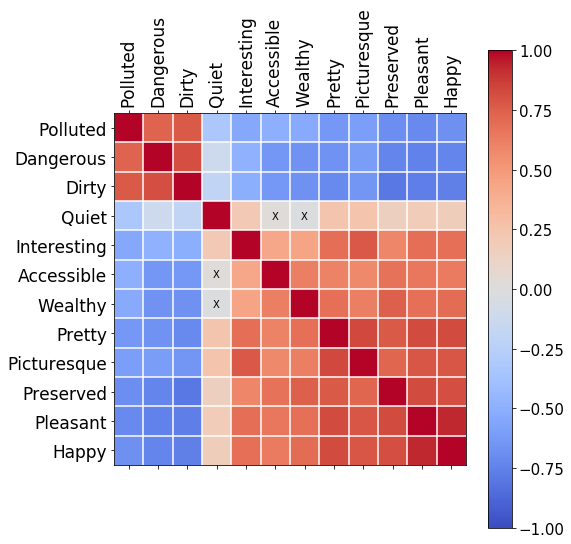

In [35]:
#Plotting the correlation matrix
fig, ax = plt.subplots(figsize=(8, 8))
cax=ax.matshow(df_labels_new.corr(method='spearman'),cmap=plt.get_cmap('coolwarm'), vmin=-1, vmax=1)
ax.xaxis.set_major_locator(matplotlib.ticker.MultipleLocator(1))
ax.yaxis.set_major_locator(matplotlib.ticker.MultipleLocator(1))
ax.set_xticklabels([""]+labels_list)
ax.set_yticklabels([""]+labels_list)
plt.xticks(rotation=90,fontsize=17)
plt.yticks(rotation=0,fontsize=17) 

#Plotting the grid
j=-0.5
for i in range(len(labels_list)):
    ax.axhline(j, linestyle='-', color='white')
    ax.axvline(j, linestyle='-', color='white')
    j=j+1

#Marking those labels that are not statistically significant at p<0.05
pvalmat= np.zeros((len(labels_list), len(labels_list)))
for i in range(len(labels_list)):    
    for j in range(len(labels_list)):        
        pvalmat[i,j] = scipy.stats.mstats.spearmanr(df_labels_new[df_labels_new.columns[i]], df_labels_new[df_labels_new.columns[j]])[1]
        if pvalmat[i,j]>0.05:
            ax.text(i, j, "X", va='center', ha='center')

            
cbar = fig.colorbar(cax)
cbar.ax.tick_params(labelsize=15)
fig.tight_layout()
plt.savefig('plots/mturk_correlation_all_labels.jpg',dpi=900)

# t-SNE analysis on GoogLeNet places365

In [24]:
color=plt.cm.tab20b(12)
np.array(color)

array([ 0.51764706,  0.23529412,  0.22352941,  1.        ])

In [25]:
#Taken from http://scikit-learn.org/stable/auto_examples/manifold/plot_lle_digits.html#sphx-glr-auto-examples-manifold-plot-lle-digits-py
#With some little modifications made by me.

# Authors: Fabian Pedregosa <fabian.pedregosa@inria.fr>
#          Olivier Grisel <olivier.grisel@ensta.org>
#          Mathieu Blondel <mathieu@mblondel.org>
#          Gael Varoquaux
# License: BSD 3 clause (C) INRIA 2011
def plot_embedding(X,n_samples,Y,plot_title,print_pictures=True,print_values=True):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)

    plt.figure(figsize=[50,50])
    ax = plt.subplot(111)
    if print_values:
        for i in range(X.shape[0]):
            if Y[i]==1:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(1),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==1.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(1),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==2:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(2),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==2.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(2),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==3:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set2(5),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==3.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set2(5),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==4:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(4),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==4.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(4),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(0),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==5.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(0),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==6:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(16),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==6.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(16),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==7.0:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(12),fontdict={'weight': 'bold', 'size': 30})
    if print_pictures:
        if hasattr(offsetbox, 'AnnotationBbox'):
            shown_images = np.array([[1, 1]])
            for i in range(n_samples):
                dist = np.sum((X[i] - shown_images) ** 2, 1)
                if np.min(dist) < 4e-5:
                    continue
                shown_images = np.r_[shown_images, [X[i]]]
                imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(RGB_pictures_order[i]),X[i])
                ax.add_artist(imagebox)
    p1 = mpatches.Patch(color=plt.cm.Set1(1), label='1.0-1.5')
    p2 = mpatches.Patch(color=plt.cm.Set1(2), label='2.0-2.5')
    p3 = mpatches.Patch(color=plt.cm.Set2(5), label='3.0-3.5')
    p4 = mpatches.Patch(color=plt.cm.Set1(4), label='4.0-4.5')
    p5 = mpatches.Patch(color=plt.cm.Set1(0), label='5.0-5.5')
    p6 = mpatches.Patch(color=plt.cm.tab20b(16), label='6.0-6.5')
    p7 = mpatches.Patch(color=plt.cm.tab20b(12), label='7.0')

    plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7],prop={'size':30})
    plt.xticks([]), plt.yticks([])
    plt.title(plot_title,fontsize= 45)

In [26]:
dir_features_places365="datasets/googlenet_places365-class-prob-summary.csv"
dir_labels="datasets/all-places-all-labels-median-medina.csv"
img_dir = 'city-image-corpus/'

In [27]:
#Getting RGB values of the pictures
pictures=[]
RGB_pictures=[]
for picture in glob.glob(img_dir+"*.jpg"):
    im=cv2.imread(picture)
    im=cv2.resize(im, (0,0), fx=0.075, fy=0.075) 
    RGB_pictures.append(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    pictures.append(os.path.basename(picture))

In [28]:
df_rgb_pictures=pd.DataFrame(RGB_pictures)
df_pictures=pd.DataFrame(pictures)
df_pictures["RGB"]=df_rgb_pictures
df_pictures=df_pictures.rename(columns = {0:'image_name'})

In [29]:
#Getting features dataframe
X=features_p365.drop(["most_prob_feat","prob"],axis=1).copy()
n_samples, n_features=X.shape
#Getting labels dataframe
Y=pd.read_csv(dir_labels).drop(["city"],axis=1)
Y=Y.rename(columns = {'annotation':'image_name'})
labels=Y.columns
labels=labels[labels!="image_name"].tolist()
#Merging both datasets in base to the image file
df_merge=pd.merge(X,Y,on="image_name")
#Merging the latter with the dataframe with the RGB in order to have the correct order of pictures.
df_pictures_order=pd.merge(df_merge,df_pictures,on="image_name")
#Getting the list of RGB codes with the correct order
RGB_pictures_order=df_pictures_order["RGB"].tolist()

In [31]:
df_merge.head()

,image_name,airfield,airplane_cabin,airport_terminal,alcove,alley,amphitheater,amusement_arcade,amusement_park,apartment_building/outdoor,...,Pretty,Preserved,Accessible,Interesting,Picturesque,Wealthy,Quiet,Polluted,Pleasant,Happy
0,s_20140712_144123.jpg,0.000004,0.000007,0.000006,7.489374e-07,0.224470,0.000042,0.000011,0.000668,0.000399,...,2.0,2.0,3.0,2.5,2.0,2.0,2.5,6.0,2.0,2.0
1,s_20140531_104057.jpg,0.000041,0.000032,0.000054,2.594588e-05,0.019120,0.000822,0.000023,0.000392,0.008307,...,3.0,4.5,6.0,3.5,3.0,4.0,4.0,2.0,4.5,4.0
2,s_20140724_153037.jpg,0.000005,0.000005,0.000366,1.807322e-06,0.073503,0.000031,0.000070,0.000513,0.000147,...,2.0,3.0,4.0,2.5,2.0,2.5,2.0,4.0,2.5,2.5
3,s_20140712_143102.jpg,0.000002,0.000004,0.000005,3.099337e-07,0.069832,0.000010,0.000007,0.000082,0.000217,...,3.0,4.0,5.5,3.0,3.0,2.0,4.0,3.0,3.5,3.5
4,s_20140726_112633.jpg,0.000069,0.000005,0.000119,4.405641e-06,0.136932,0.000184,0.000028,0.000789,0.000272,...,2.0,2.5,3.5,2.5,2.0,1.5,3.5,3.5,3.0,3.0


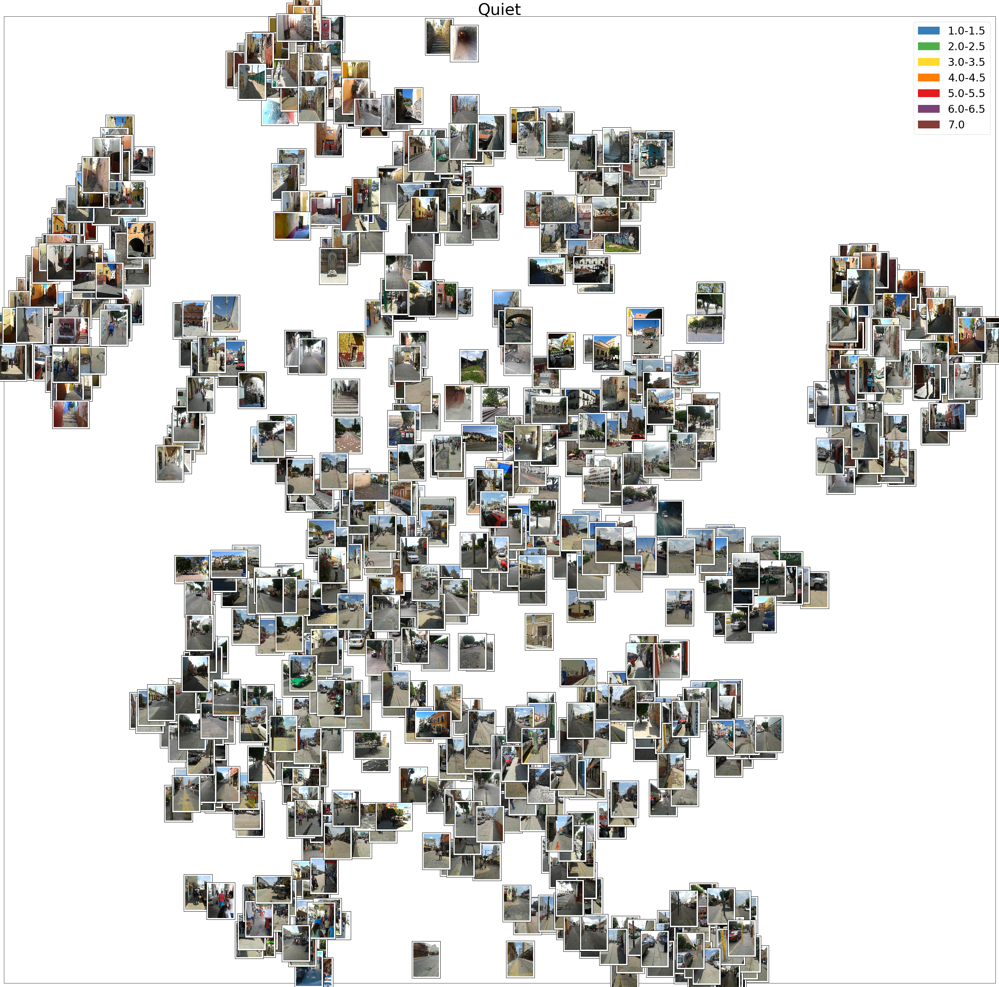

In [32]:
#Since the plot of the position of the different pictures is technically the same between the labels (however, the values will change), we can only plot it once
#Taking one random label to generate the plot with the pictures
label="Quiet"
#Applying TSNE
tsne = TSNE(n_components=2, random_state=0)
X_tsne = tsne.fit_transform(df_merge.drop(labels+["image_name"],axis=1))
#Getting the plot of the pictures
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=True,print_values=False,plot_title=label)
plt.savefig('plots/tsne_analysis/googlenet_places365/tsne_places365_pictures.jpg')

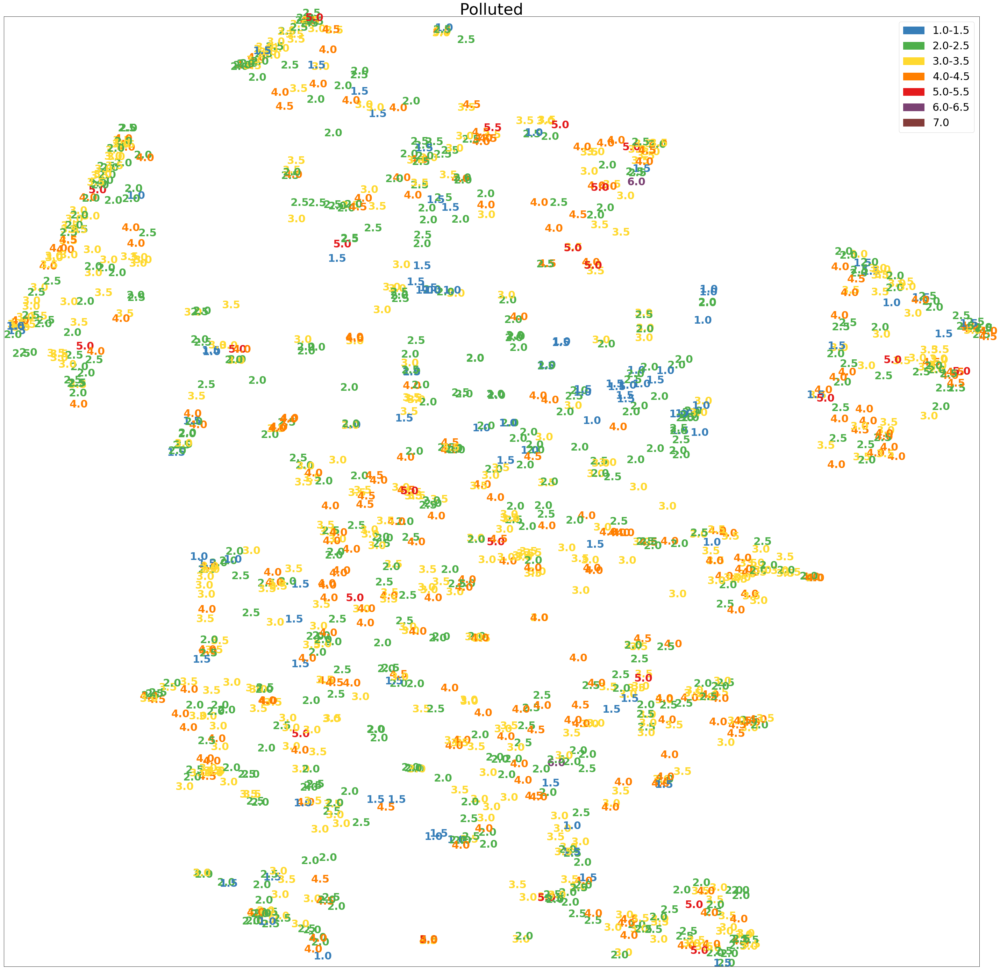

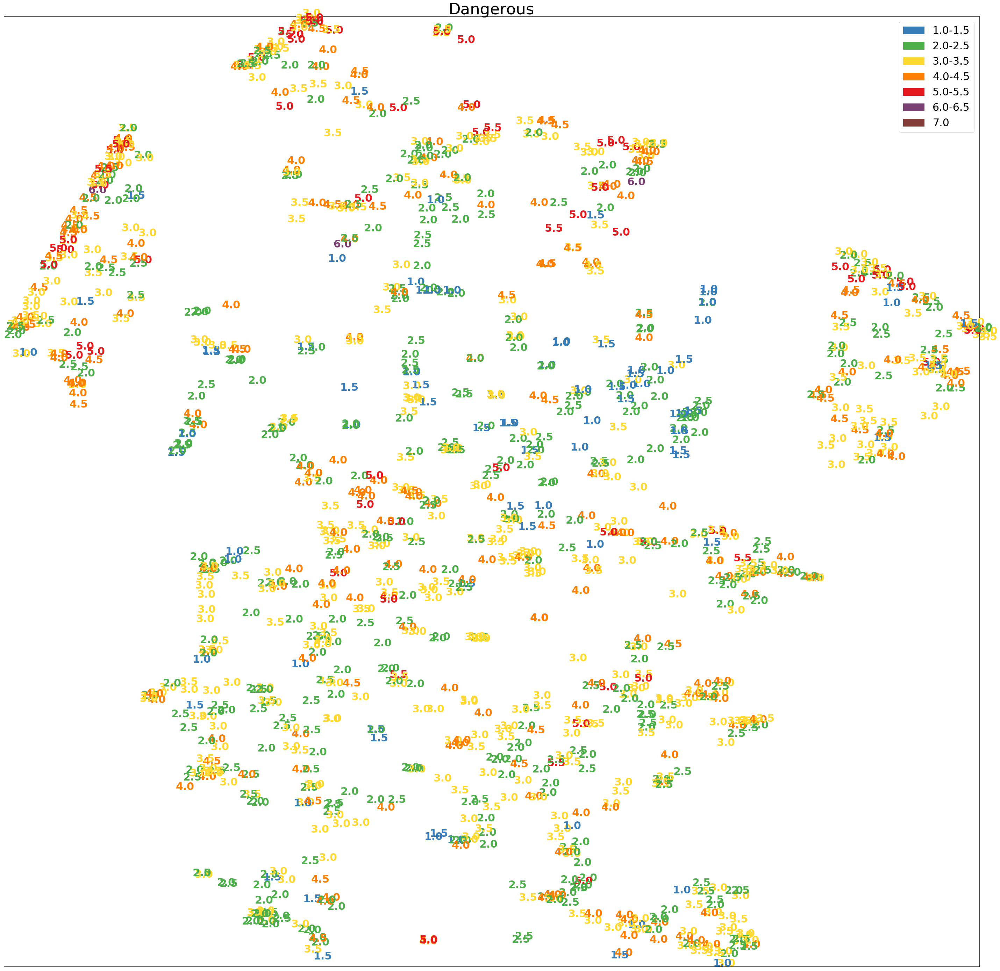

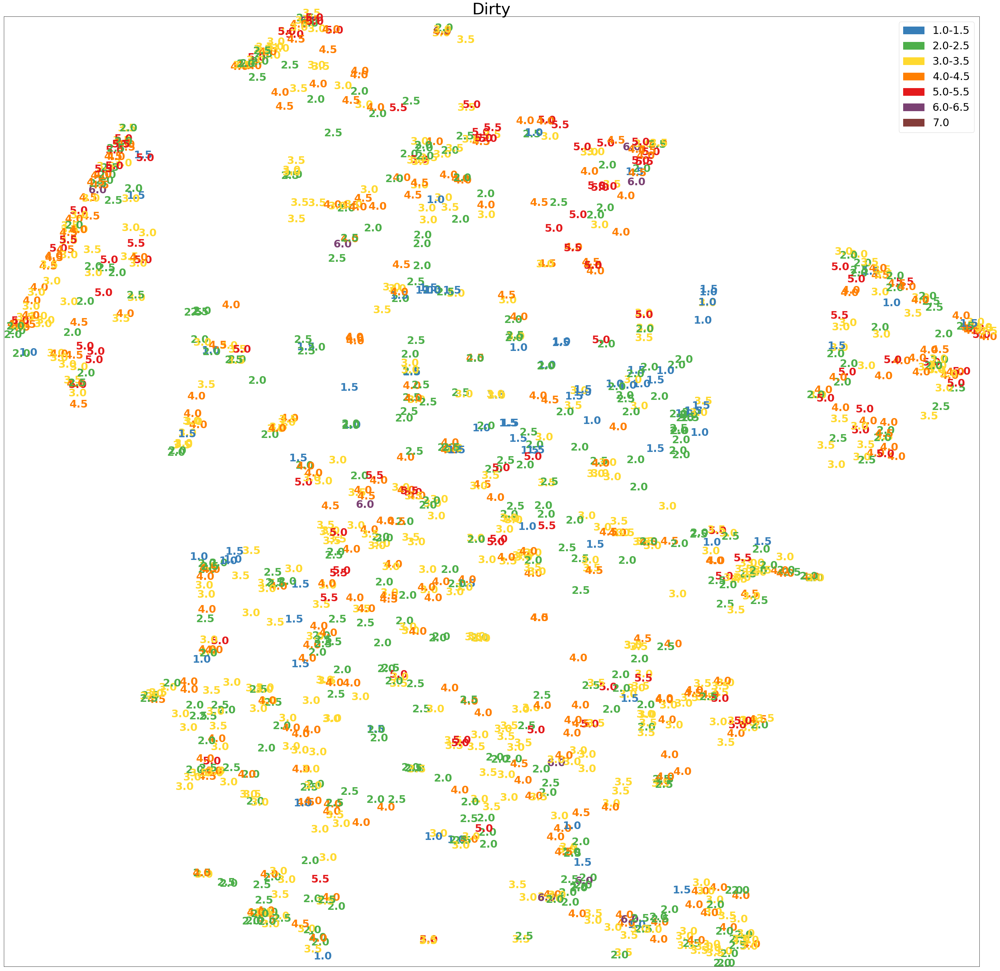

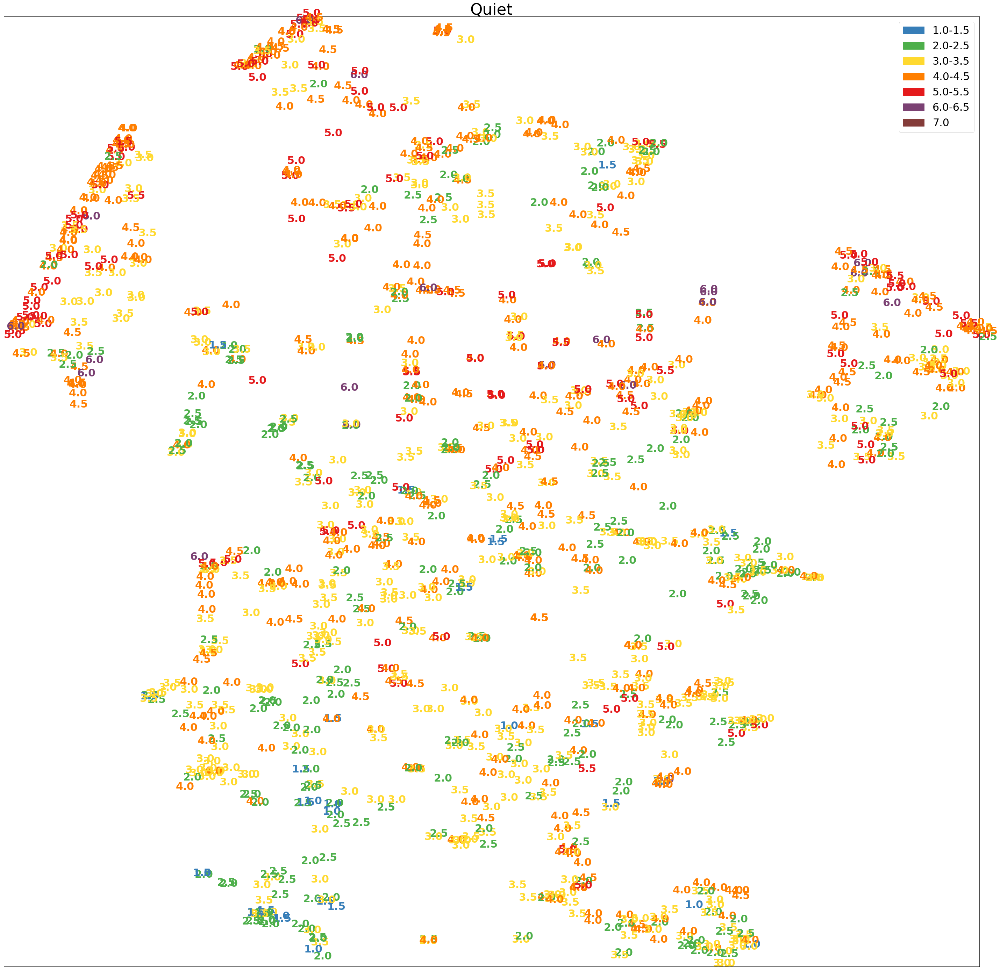

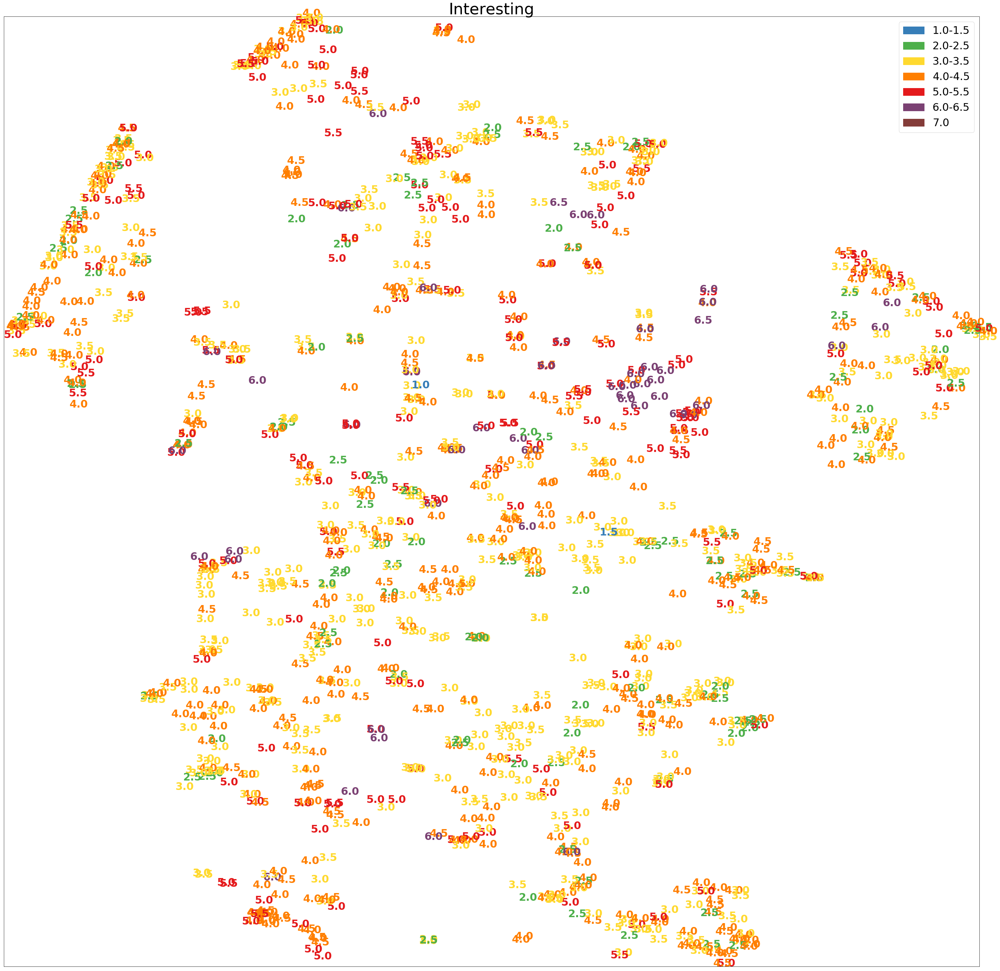

...

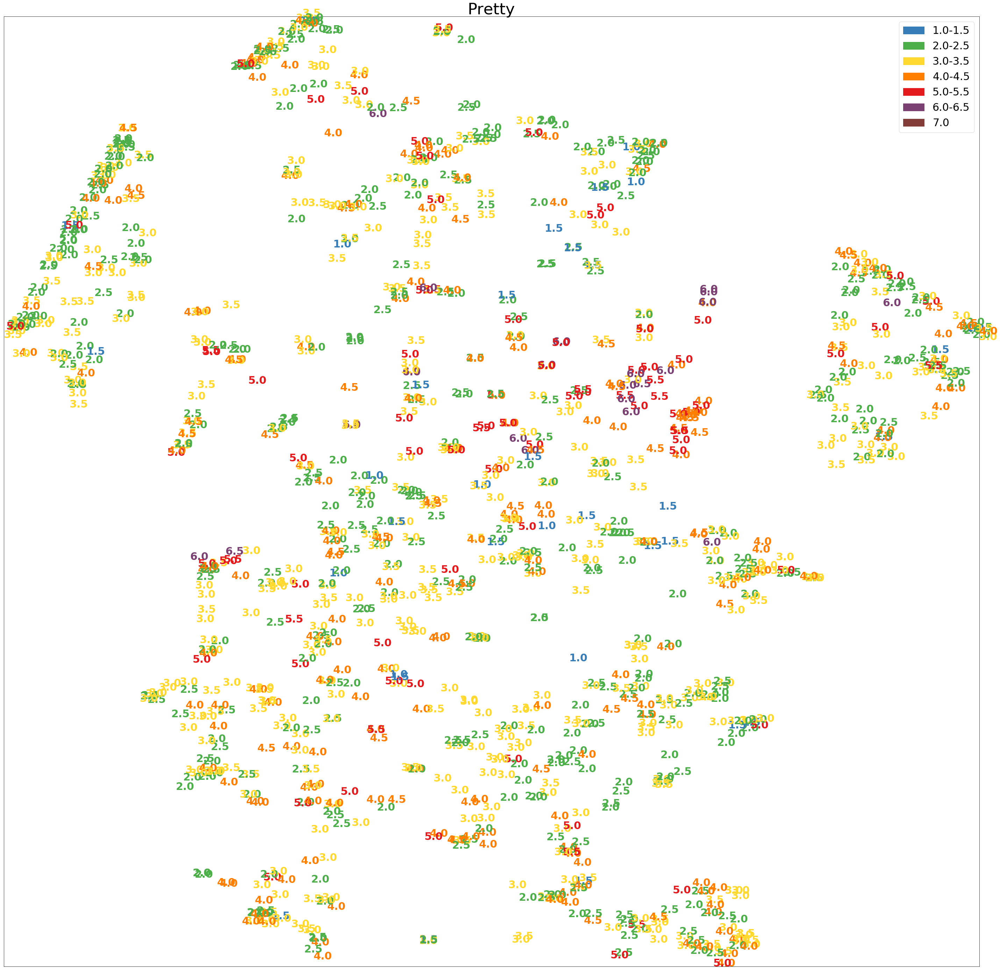

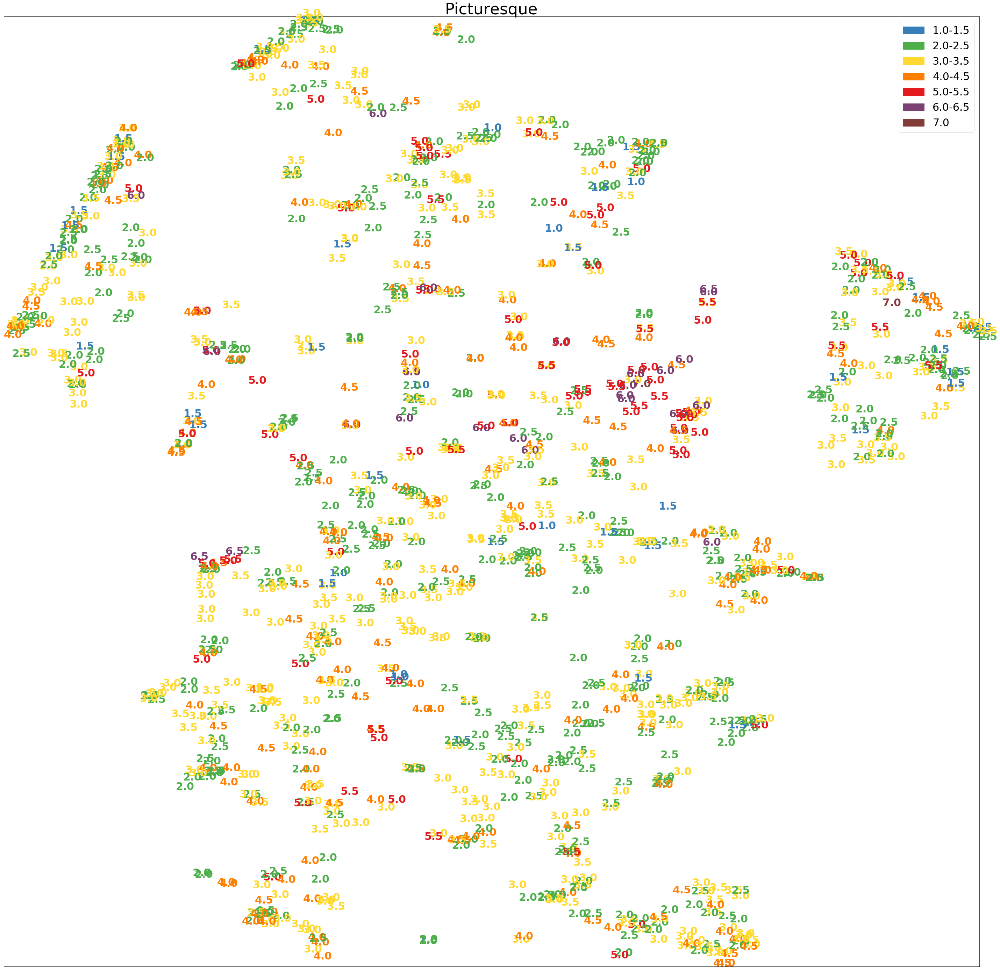

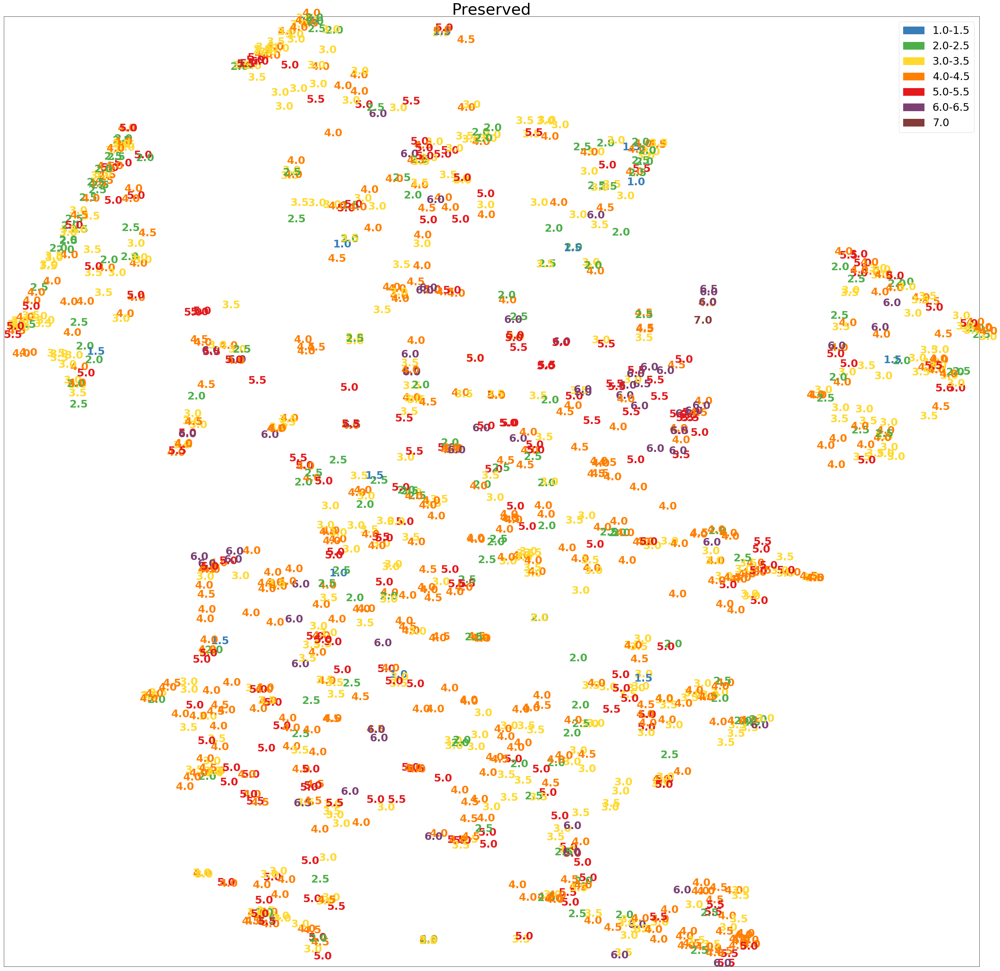

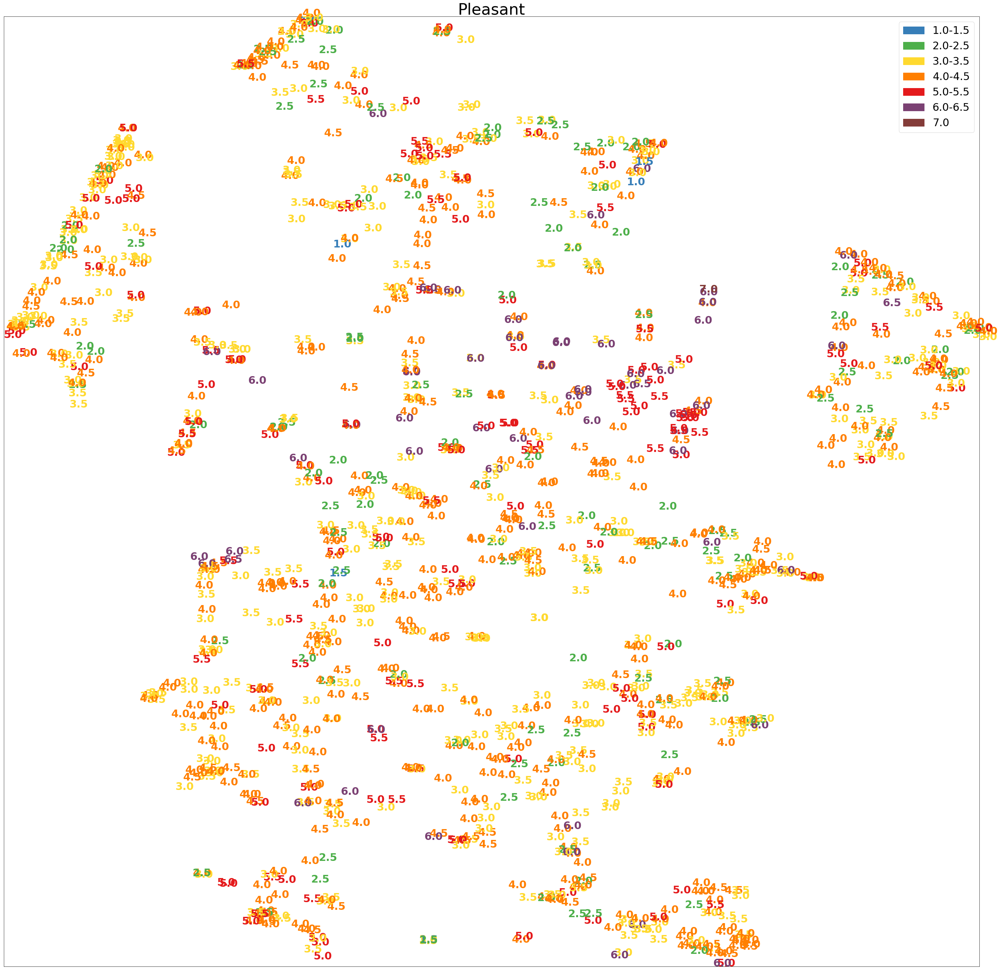

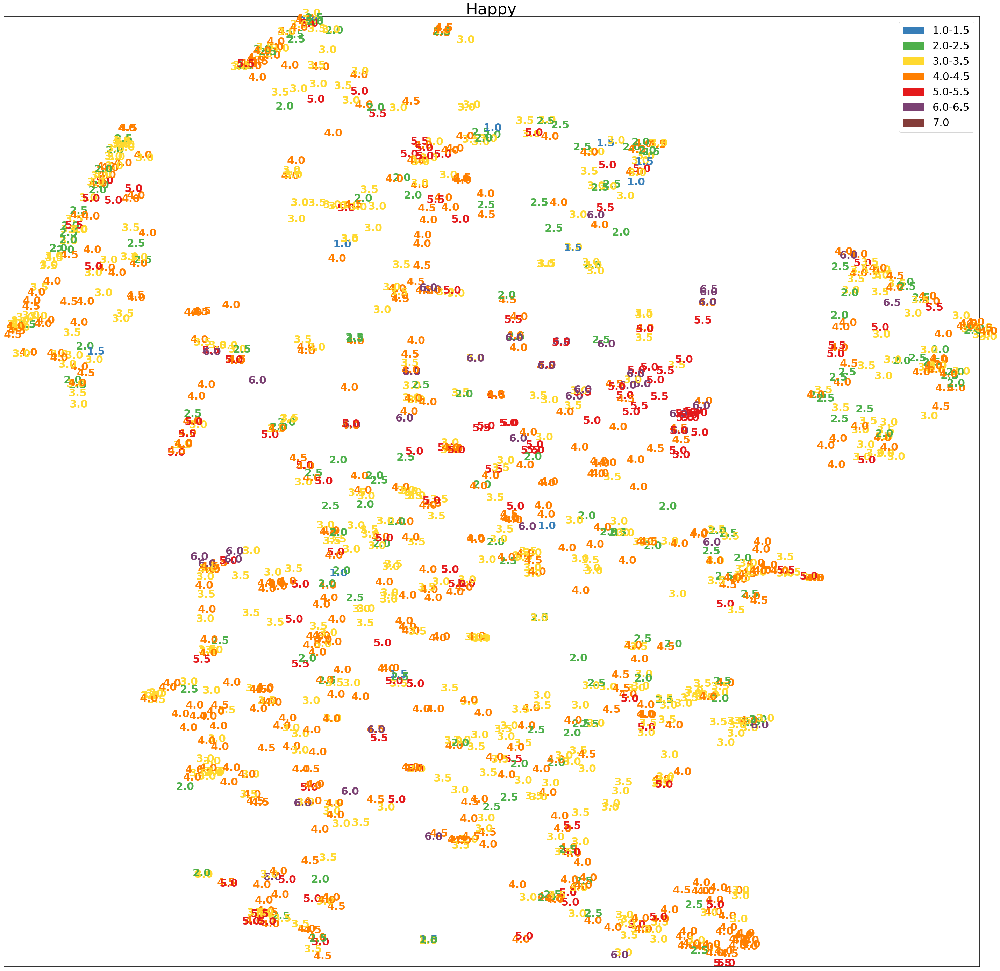

In [35]:
#Analyzing each of the labels with the t-SNE analysis
for label in labels_list:
    plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
    #plt.show()
    plt.savefig('plots/tsne_analysis/googlenet_places365/tsne_places365_'+label+'_values.jpg')

# Correlation analysis on DilatedNet Semantic Segmentation

In [227]:
df_labels=all_labels.rename(index=str, columns={"annotation": "image_name"}).copy()
df_merge_ss150=pd.merge(features_ss150,df_labels,on="image_name")

In [228]:
df_correlation=df_merge_ss150.drop(['image_name','city',"most_prob_feat","prob"], axis=1).corr(method='spearman')

In [234]:
#Getting the "most" correlated features 
threshold_corr=0.12
p_val_compare=0.05
dict_corr_feat_label=dict()
dict_corr_feat_label_2=dict()
temp=[]
temp_corr=[]
print("Number of correlated features for each label\n")
for column in df_correlation[labels].columns.tolist(): #going through labels
    for row in df_correlation[(df_correlation[column]>=threshold_corr) | (df_correlation[column]<=-threshold_corr)][column].index.tolist():
        if row not in labels:
            p_val=stats.spearmanr(df_merge_ss150[column],df_merge_ss150[row])[1]
            corre=stats.spearmanr(df_merge_ss150[column],df_merge_ss150[row])[0]
            if p_val<p_val_compare:
                temp.append(str(row+": ")+str(round(df_correlation[column][row],3))+" p_value: "+ str(p_val)) 
                temp_corr.append([row,round(df_correlation[column][row],3)])
    dict_corr_feat_label[column]=temp
    dict_corr_feat_label_2[column]=temp_corr
    print(str(column)+": " +str(len(temp))+" correlated features")
    temp=[]
    temp_corr=[]
print("\n\nMost correlated features:")
dict_corr_feat_label

Number of correlated features for each label

Dangerous: 14 correlated features
Dirty: 9 correlated features
Pretty: 11 correlated features
Preserved: 12 correlated features
Accessible: 16 correlated features
Interesting: 14 correlated features
Picturesque: 10 correlated features
Wealthy: 17 correlated features
Quiet: 24 correlated features
Polluted: 9 correlated features
Pleasant: 12 correlated features
Happy: 11 correlated features


Most correlated features:


{'Accessible': ['wall: -0.345 p_value: 7.88724203281e-35',
  'building : -0.17 p_value: 3.42450545776e-09',
  'tree: 0.297 p_value: 7.28385573898e-26',
  'windowpane : -0.124 p_value: 1.58587650344e-05',
  'sidewalk : 0.315 p_value: 4.52447891921e-29',
  'person : 0.263 p_value: 1.68526102745e-20',
  'earth : -0.138 p_value: 1.57392852923e-06',
  'door : -0.211 p_value: 1.40961668198e-13',
  'plant : 0.13 p_value: 6.42362841705e-06',
  'curtain : -0.134 p_value: 3.04094599979e-06',
  'painting : -0.179 p_value: 3.81948385997e-10',
  'stairs : -0.193 p_value: 1.44276163022e-11',
  'stairway : -0.165 p_value: 8.50738616837e-09',
  'hovel : -0.138 p_value: 1.61952600084e-06',
  'dirt track: -0.171 p_value: 2.37693345901e-09',
  'ashcan : 0.123 p_value: 2.03834860204e-05'],
 'Dangerous': ['wall: 0.181 p_value: 2.95459396637e-10',
  'building : 0.129 p_value: 7.95871289667e-06',
  'tree: -0.253 p_value: 5.5234602238e-19',
  'road : 0.123 p_value: 1.84267566166e-05',
  'sidewalk : -0.254 p_v

In [306]:
#Sorting the features
for key in dict_corr_feat_label_2:
    test=pd.DataFrame(dict_corr_feat_label_2[key],columns=["object","corr"])
    test["abs"]=test['corr'].abs()
    test=test.sort_values(by="abs",ascending=False).drop(["abs"],axis=1)
    print("label: "+key+" | Number of correlated features: "+str(len(test)))
    print(test)
    print("\n")

label: Dangerous | Number of correlated features: 14
        object   corr
4    sidewalk  -0.254
2         tree -0.253
5      person  -0.234
7    painting   0.188
9        bench -0.184
0         wall  0.181
6       plant  -0.155
8        base  -0.152
12        pole  0.138
11  dirt track  0.134
1    building   0.129
10     awning  -0.125
13     ashcan  -0.124
3        road   0.123


label: Dirty | Number of correlated features: 9
       object   corr
1        tree -0.227
2   sidewalk  -0.216
8  dirt track  0.190
0        wall  0.170
6   painting   0.162
7       bench -0.154
3     person  -0.151
5      plant  -0.147
4      earth   0.145


label: Pretty | Number of correlated features: 11
        object   corr
1         tree  0.242
5       plant   0.186
3    sidewalk   0.170
2        road  -0.160
9   dirt track -0.154
4      person   0.147
7        bench  0.144
0         wall -0.141
6    painting  -0.141
10        pole -0.141
8       truck  -0.123


label: Preserved | Number of correlated

# Correlation analysis on GoogLeNet places205

In [335]:
#Reading the features file and naming the columns
feats=np.loadtxt("datasets/categoryIndex_places205.csv",dtype=bytes,usecols=0).astype(str)
feats=[e[3:] for e in feats]
feats=np.append(["image_name","most_prob_feat","prob"],feats)
features_p205=pd.read_csv("datasets/googlenet_places205-class-prob-summary.csv",header=None,names=feats)
features_p205["most_prob_feat"]=[e[3:].split(" ")[0] for e in features_p205["most_prob_feat"]]
features_p205["image_name"]=[e[3:] for e in features_p205["image_name"]]

In [336]:
df_labels=all_labels.rename(index=str, columns={"annotation": "image_name"}).copy()
df_merge_places205=pd.merge(features_p205,df_labels,on="image_name")

In [337]:
df_correlation=df_merge_places205.drop(['image_name','city',"most_prob_feat","prob"], axis=1).corr(method='spearman')

In [340]:
#Getting the "most" correlated features 
threshold_corr=0.3
p_val_compare=0.05
dict_corr_feat_label=dict()
dict_corr_feat_label_2=dict()
temp=[]
temp_corr=[]
print("Number of correlated features for each label\n")
for column in df_correlation[labels].columns.tolist(): #going through labels
    for row in df_correlation[(df_correlation[column]>=threshold_corr) | (df_correlation[column]<=-threshold_corr)][column].index.tolist():
        if row not in labels:
            p_val=stats.spearmanr(df_merge_places205[column],df_merge_places205[row])[1]
            corre=stats.spearmanr(df_merge_places205[column],df_merge_places205[row])[0]
            if p_val<p_val_compare:
                temp.append(str(row+": ")+str(round(df_correlation[column][row],3))+" p_value: "+ str(p_val)) 
                temp_corr.append([row,round(df_correlation[column][row],3)])
    dict_corr_feat_label[column]=temp
    dict_corr_feat_label_2[column]=temp_corr
    print(str(column)+": " +str(len(temp))+" correlated features")
    temp=[]
    temp_corr=[]
#print("\n\nMost correlated features:")
#dict_corr_feat_label

Number of correlated features for each label

Dangerous: 19 correlated features
Dirty: 15 correlated features
Pretty: 21 correlated features
Preserved: 25 correlated features
Accessible: 48 correlated features
Interesting: 19 correlated features
Picturesque: 20 correlated features
Wealthy: 44 correlated features
Quiet: 71 correlated features
Polluted: 4 correlated features
Pleasant: 22 correlated features
Happy: 26 correlated features


In [341]:
#Sorting the features
for key in dict_corr_feat_label_2:
    test=pd.DataFrame(dict_corr_feat_label_2[key],columns=["object","corr"])
    test["abs"]=test['corr'].abs()
    test=test.sort_values(by="abs",ascending=False).drop(["abs"],axis=1)
    print("label: "+key+" | Number of correlated features: "+str(len(test)))
    print(test)
    print("\n")

label: Dangerous | Number of correlated features: 19
               object   corr
16              plaza -0.437
12      hotel/outdoor -0.364
7   cathedral/outdoor -0.361
11           fountain -0.360
4    botanical_garden -0.359
1        banquet_hall -0.356
18     topiary_garden -0.355
17   restaurant_patio -0.349
14             palace -0.344
15           pavilion -0.336
10      formal_garden -0.335
6          courthouse -0.334
8      church/outdoor -0.331
0            ballroom -0.330
3            basilica -0.323
9          food_court -0.311
5           cafeteria -0.309
13        inn/outdoor -0.308
2            basement  0.300


label: Dirty | Number of correlated features: 15
               object   corr
12              plaza -0.395
10      hotel/outdoor -0.352
6   cathedral/outdoor -0.345
11             palace -0.334
13               slum  0.332
4    botanical_garden -0.321
5          courthouse -0.321
7      church/outdoor -0.321
9            fountain -0.319
3            basilica -0.3

# Correlation analysis on GoogLeNet places365

In [36]:
df_labels=all_labels.rename(index=str, columns={"annotation": "image_name"}).copy()
df_merge_places365=pd.merge(features_p365,df_labels,on="image_name")

In [37]:
df_correlation=df_merge_places365.drop(['image_name','city',"most_prob_feat","prob"], axis=1).corr(method='spearman')

In [38]:
#Getting the "most" correlated features 
threshold_corr=0.3
p_val_compare=0.05
dict_corr_feat_label=dict()
dict_corr_feat_label_2=dict()
temp=[]
temp_corr=[]
print("Number of correlated features for each label\n")
for column in df_correlation[labels].columns.tolist(): #going through labels
    for row in df_correlation[(df_correlation[column]>=threshold_corr) | (df_correlation[column]<=-threshold_corr)][column].index.tolist():
        if row not in labels:
            p_val=stats.spearmanr(df_merge_places365[column],df_merge_places365[row])[1]
            corre=stats.spearmanr(df_merge_places365[column],df_merge_places365[row])[0]
            if p_val<p_val_compare:
                temp.append(str(row+": ")+str(round(df_correlation[column][row],3))+" p_value: "+ str(p_val)) 
                temp_corr.append([row,round(df_correlation[column][row],3)])
    dict_corr_feat_label[column]=temp
    dict_corr_feat_label_2[column]=temp_corr
    print(str(column)+": " +str(len(temp))+" correlated features")
    temp=[]
    temp_corr=[]
#print("\n\nMost correlated features:")
#dict_corr_feat_label

Number of correlated features for each label

Dangerous: 28 correlated features
Dirty: 17 correlated features
Pretty: 23 correlated features
Preserved: 30 correlated features
Accessible: 67 correlated features
Interesting: 5 correlated features
Picturesque: 8 correlated features
Wealthy: 50 correlated features
Quiet: 60 correlated features
Polluted: 4 correlated features
Pleasant: 20 correlated features
Happy: 17 correlated features


In [39]:
#Sorting the features
for key in dict_corr_feat_label_2:
    test=pd.DataFrame(dict_corr_feat_label_2[key],columns=["object","corr"])
    test["abs"]=test['corr'].abs()
    test=test.sort_values(by="abs",ascending=False).drop(["abs"],axis=1)
    print("label: "+key+" | Number of correlated features: "+str(len(test)))
    print(test)
    print("\n")

label: Dangerous | Number of correlated features: 28
                  object   corr
23                 plaza -0.432
7                 campus -0.410
3            beer_garden -0.398
2           banquet_hall -0.388
14       gazebo/exterior -0.380
26  shopping_mall/indoor -0.377
15         hotel/outdoor -0.372
1               ballroom -0.364
9            dining_hall -0.362
8              carrousel -0.358
25      restaurant_patio -0.356
24            restaurant -0.355
0          atrium/public -0.338
22              pavilion -0.330
4              beer_hall -0.329
27        topiary_garden -0.326
6              cafeteria -0.322
5       botanical_garden -0.319
12         formal_garden -0.317
10   florist_shop/indoor -0.314
21                  park -0.313
16       japanese_garden -0.311
18        museum/outdoor -0.310
17               mansion -0.308
19          nursing_home -0.306
20                palace -0.306
13              fountain -0.305
11            food_court -0.302


label: Dirty | Nu